# Team KIM - Kaggle Tabular Playground Series - May 2022
## EDA and DataFrame Version Control

In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
import pandas_profiling

%matplotlib inline
plt.rcParams['figure.figsize'] = (8, 6)

In [3]:
# Functions to be used in feature engineering below
def augment(df, df_new):
    return pd.concat([df,df_new], axis=1)

In [246]:
# Call up raw training and test files
df = pd.read_csv('./train.csv'); df_test = pd.read_csv('./test.csv')
df.head(5)

,id,f_00,f_01,f_02,f_03,f_04,f_05,f_06,f_07,f_08,...,f_22,f_23,f_24,f_25,f_26,f_27,f_28,f_29,f_30,target
0,0,-1.373246,0.238887,-0.243376,0.567405,-0.647715,0.839326,0.113133,1,5,...,-2.540739,0.766952,-2.730628,-0.208177,1.363402,ABABDADBAB,67.609153,0,0,0
1,1,1.697021,-1.710322,-2.230332,-0.545661,1.113173,-1.552175,0.447825,1,3,...,2.278315,-0.633658,-1.217077,-3.782194,-0.058316,ACACCADCEB,377.096415,0,0,1
2,2,1.681726,0.616746,-1.027689,0.810492,-0.609086,0.113965,-0.708660,1,0,...,-1.385775,-0.520558,-0.009121,2.788536,-3.703488,AAAEABCKAD,-195.599702,0,2,1
3,3,-0.118172,-0.587835,-0.804638,2.086822,0.371005,-0.128831,-0.282575,3,2,...,0.572594,-1.653213,1.686035,-2.533098,-0.608601,BDBBAACBCB,210.826205,0,0,1
4,4,1.148481,-0.176567,-0.664871,-1.101343,0.467875,0.500117,0.407515,3,3,...,-3.912929,-1.430366,2.127649,-3.306784,4.371371,BDBCBBCHFE,-217.211798,0,1,1


####  id and f_27 cols not predictive and will be removed in pre-processing, but will explore feature engineering on f_27

In [5]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 900000 entries, 0 to 899999
Data columns (total 33 columns):
 #   Column  Non-Null Count   Dtype  
---  ------  --------------   -----  
 0   id      900000 non-null  int64  
 1   f_00    900000 non-null  float64
 2   f_01    900000 non-null  float64
 3   f_02    900000 non-null  float64
 4   f_03    900000 non-null  float64
 5   f_04    900000 non-null  float64
 6   f_05    900000 non-null  float64
 7   f_06    900000 non-null  float64
 8   f_07    900000 non-null  int64  
 9   f_08    900000 non-null  int64  
 10  f_09    900000 non-null  int64  
 11  f_10    900000 non-null  int64  
 12  f_11    900000 non-null  int64  
 13  f_12    900000 non-null  int64  
 14  f_13    900000 non-null  int64  
 15  f_14    900000 non-null  int64  
 16  f_15    900000 non-null  int64  
 17  f_16    900000 non-null  int64  
 18  f_17    900000 non-null  int64  
 19  f_18    900000 non-null  int64  
 20  f_19    900000 non-null  float64
 21  f_20    90

In [6]:
df.describe()

,id,f_00,f_01,f_02,f_03,f_04,f_05,f_06,f_07,f_08,...,f_21,f_22,f_23,f_24,f_25,f_26,f_28,f_29,f_30,target
count,900000.000000,900000.000000,900000.000000,900000.000000,900000.000000,900000.000000,900000.000000,900000.000000,900000.000000,900000.000000,...,900000.000000,900000.000000,900000.000000,900000.000000,900000.000000,900000.000000,900000.000000,900000.000000,900000.000000,900000.000000
mean,449999.500000,-0.000286,0.001165,0.001174,-0.001368,-0.000571,0.000284,-0.000709,2.031460,2.057998,...,-0.156307,-0.009273,-0.369459,-0.342738,0.176549,0.357591,-0.380876,0.345661,1.002654,0.486488
std,259807.765474,0.998888,0.999193,1.000514,1.000175,1.000167,0.999875,0.999942,1.656172,1.590955,...,2.484706,2.450797,2.453405,2.386941,2.416959,2.476020,238.773054,0.475584,0.818989,0.499818
min,0.000000,-4.599856,-4.682199,-4.642676,-4.658816,-4.748501,-4.750214,-4.842919,0.000000,0.000000,...,-13.310146,-11.853530,-12.301097,-11.416189,-11.918306,-14.300577,-1229.753052,0.000000,0.000000,0.000000
25%,224999.750000,-0.675490,-0.675162,-0.674369,-0.676114,-0.675909,-0.673437,-0.674876,1.000000,1.000000,...,-1.820063,-1.645585,-2.019739,-1.955956,-1.440424,-1.261598,-159.427418,0.000000,0.000000,0.000000
50%,449999.500000,0.001144,0.002014,0.002218,-0.002227,-0.001662,-0.000438,-0.001492,2.000000,2.000000,...,-0.152668,0.030850,-0.390966,-0.340746,0.160912,0.404212,-0.519808,0.000000,1.000000,0.000000
75%,674999.250000,0.674337,0.675021,0.677505,0.672544,0.673789,0.675028,0.674749,3.000000,3.000000,...,1.507071,1.661676,1.255408,1.266673,1.795928,2.028219,158.987357,1.000000,2.000000,1.000000
max,899999.000000,4.749301,4.815699,4.961982,4.454920,4.948983,4.971881,4.822668,15.000000,16.000000,...,14.455426,11.344080,12.247100,12.389844,12.529179,12.913041,1229.562577,1.000000,2.000000,1.000000


In [7]:
# Large dataset, will explore below
df.shape

(900000, 33)

## EDA

In [7]:
# Data is clean, no dupes 
df.duplicated().sum()

0

In [8]:
# Data also appears fairly balanced so will attempt without re-sampling
df.target.value_counts(normalize=True)

0    0.513512
1    0.486488
Name: target, dtype: float64

### EDA: Pandas Profiling 

In [8]:
pandas_profiling.ProfileReport(df)

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
#pandas_profiling.ProfileReport(df).to_file('output.html')

### Exploring feature relation to target 
#### We note certain features appear to have more predictive value, especially cols where data means attibuted to 0/1 target values vary by a lot, i.e. f_00, f_01, f_02, f_05, f_08, f_09, f_11, f_19, f_20, f_21, f_22, f_23, f_24, f_26, f_28

In [9]:
df.groupby(['target'])[['f_00','f_01','f_02','f_03','f_04','f_05','f_06','f_07','f_08','f_09']].agg(['mean']).round(3)

,f_00,f_01,f_02,f_03,f_04,f_05,f_06,f_07,f_08,f_09
,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean
target,,,,,,,,,,
0,-0.054,-0.052,-0.030,-0.001,-0.001,-0.032,0.000,2.023,2.003,2.254
1,0.056,0.058,0.034,-0.002,-0.000,0.034,-0.002,2.040,2.117,2.477


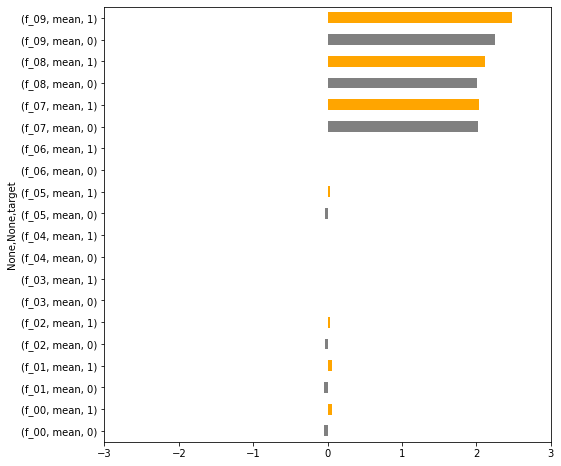

In [10]:
fig1 = plt.figure(figsize=(8,8));

df.groupby(['target'])[['f_00','f_01','f_02','f_03','f_04','f_05','f_06','f_07','f_08','f_09']].agg(['mean']).unstack().plot.barh(color=['gray','orange'])
plt.xlim(-3,3)
plt.show()

In [11]:
df.groupby(['target'])[['f_10', 'f_11', 'f_12', 'f_13', 'f_14', 'f_15', 'f_16','f_17', 'f_18', 'f_19']].agg(['mean']).round(3)

,f_10,f_11,f_12,f_13,f_14,f_15,f_16,f_17,f_18,f_19
,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean
target,,,,,,,,,,
0,2.234,1.921,2.844,2.291,1.538,2.035,2.153,1.856,2.082,0.506
1,2.118,1.679,2.841,2.186,1.490,2.171,2.037,1.861,2.048,0.100


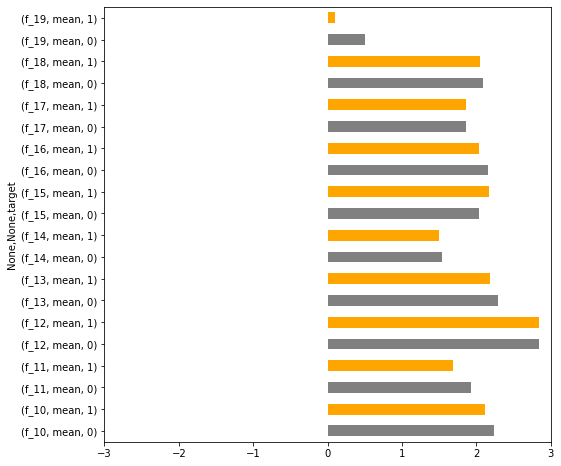

In [12]:
fig = plt.figure(figsize=(8,8));

df.groupby(['target'])[['f_10', 'f_11', 'f_12', 'f_13', 'f_14', 'f_15', 'f_16', 'f_17', 'f_18', 'f_19']].agg(['mean']).unstack().plot.barh(color=['gray','orange'])
plt.xlim(-3,3)
plt.show()

In [13]:
df.groupby(['target'])[['f_20', 'f_21', 'f_22', 'f_23', 'f_24', 'f_25','f_26', 'f_28', 'f_29', 'f_30']].agg(['mean']).round(3)

,f_20,f_21,f_22,f_23,f_24,f_25,f_26,f_28,f_29,f_30
,mean,mean,mean,mean,mean,mean,mean,mean,mean,mean
target,,,,,,,,,,
0,-0.093,-0.473,-0.166,-0.563,-0.543,0.254,0.216,-8.707,0.322,0.986
1,-0.269,0.178,0.156,-0.165,-0.131,0.095,0.507,8.407,0.371,1.020


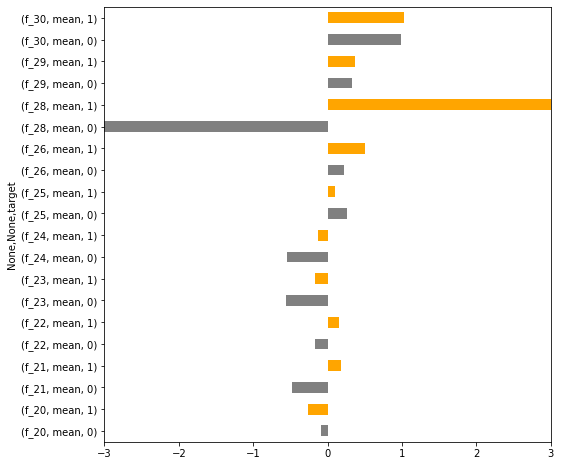

In [745]:
fig = plt.figure(figsize=(8,8));

df.groupby(['target'])[['f_20', 'f_21', 'f_22', 'f_23', 'f_24', 'f_25','f_26', 'f_28', 'f_29', 'f_30']].agg(['mean']).unstack().plot.barh(color=['gray','orange'])
plt.xlim(-3,3)
plt.show()

### EDA: Integer columns f_07 to f_18
#### The integer columns are mostly left skewed, we noticed stacking them created a normal distribution, but could not figure out how to feature engineer this finding

In [262]:
df['mean_07-18'] = df[['f_07','f_08','f_09','f_10','f_11','f_12','f_13','f_14','f_15','f_16','f_17','f_18']].mean(axis=1)

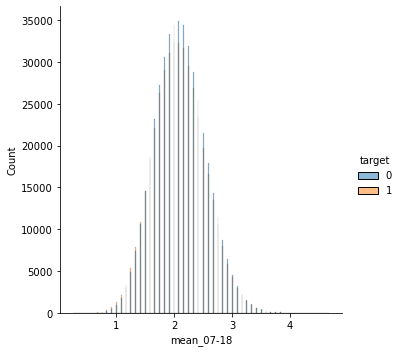

In [266]:
sns.displot(df, x='mean_07-18', hue='target')

## Feature Engineering 

### 'f_27' - String column

In [14]:
# In our first prediction attempt we overlooked f_27 taking it to be akin to contain unique values, 
# instead of predictie ones. This would prove to be a fallacy.
df.f_27.value_counts(normalize=True)

BBBBBBCJBC    0.000013
BCBBBBCLBC    0.000013
BBBBBBDPCB    0.000011
BBBBBBDKBC    0.000011
ADBBBACQBC    0.000011
                ...   
BFAFAADTCE    0.000001
BBBDAACOAE    0.000001
BBABAACGBB    0.000001
BFAABAGSDB    0.000001
BCAACADSCE    0.000001
Name: f_27, Length: 741354, dtype: float64

In [15]:
# Each row in f_27 contains ten letters, we observe the following unique features of each letter in the string
for n in range(10):
    print(f'At Position {n}: {set([df.f_27[i][n] for i in range(len(df))])}')

At Position 0: {'B', 'A'}
At Position 1: {'H', 'C', 'I', 'D', 'A', 'F', 'J', 'K', 'L', 'B', 'M', 'E', 'G', 'N'}
At Position 2: {'B', 'A'}
At Position 3: {'H', 'C', 'I', 'D', 'A', 'O', 'F', 'J', 'K', 'L', 'B', 'M', 'E', 'G', 'N'}
At Position 4: {'H', 'C', 'I', 'D', 'A', 'O', 'F', 'J', 'K', 'L', 'B', 'M', 'E', 'G'}
At Position 5: {'B', 'A'}
At Position 6: {'H', 'C', 'I', 'D', 'A', 'O', 'F', 'J', 'K', 'L', 'B', 'M', 'E', 'G', 'N'}
At Position 7: {'H', 'A', 'P', 'Q', 'N', 'S', 'C', 'R', 'K', 'T', 'I', 'D', 'O', 'L', 'J', 'E', 'G', 'F', 'B', 'M'}
At Position 8: {'H', 'C', 'I', 'D', 'A', 'O', 'F', 'J', 'L', 'K', 'B', 'M', 'E', 'G', 'N'}
At Position 9: {'H', 'C', 'I', 'D', 'A', 'O', 'F', 'J', 'K', 'L', 'B', 'M', 'E', 'G', 'N'}


In [16]:
# Fetching the associated counts of each letter, but had not been able to engineer this into a useful feature
from collections import Counter

for n in range(10):
    print(f'At Position {n}:\n{Counter([df.f_27[i][n] for i in range(len(df))])}')

At Position 0:
Counter({'A': 451207, 'B': 448793})
At Position 1:
Counter({'B': 245160, 'C': 225931, 'D': 149579, 'A': 144762, 'E': 78807, 'F': 35487, 'G': 13713, 'H': 4647, 'I': 1361, 'J': 410, 'K': 113, 'L': 25, 'M': 3, 'N': 2})
At Position 2:
Counter({'B': 602160, 'A': 297840})
At Position 3:
Counter({'B': 237218, 'C': 210015, 'A': 160839, 'D': 143633, 'E': 81662, 'F': 39504, 'G': 17121, 'H': 6473, 'I': 2379, 'J': 772, 'K': 254, 'L': 87, 'M': 32, 'N': 8, 'O': 3})
At Position 4:
Counter({'B': 284565, 'A': 259608, 'C': 196631, 'D': 98838, 'E': 38895, 'F': 14101, 'G': 5018, 'H': 1666, 'I': 484, 'J': 151, 'K': 29, 'L': 10, 'M': 3, 'O': 1})
At Position 5:
Counter({'A': 479108, 'B': 420892})
At Position 6:
Counter({'C': 220127, 'B': 200124, 'D': 173343, 'E': 107769, 'A': 101624, 'F': 56428, 'G': 25318, 'H': 9972, 'I': 3678, 'J': 1135, 'K': 328, 'L': 118, 'M': 24, 'N': 11, 'O': 1})
At Position 7:
Counter({'M': 45988, 'N': 45910, 'F': 45894, 'E': 45871, 'B': 45834, 'I': 45783, 'C': 45780, '

#### Isolating binary A/B values from string pos 0,2,5

In [856]:
# Note that positions 0, 2, 5 are A/B values, below formula to isolate them to test predictability (we tried, limited gains) 

# making column from 3 positions in f_27 that consist of A/B values only 
df2 = pd.DataFrame([df.f_27[i][0]+df.f_27[i][2]+df.f_27[i][5] for i in range(len(df))],columns=['f_27_idx025'])
one_hot_f_27 = pd.get_dummies(df2.f_27_idx025, drop_first=True)
# Merge to original df
df = augment(df,one_hot_f_27)

df2 = pd.DataFrame([df_test.f_27[i][0]+df_test.f_27[i][2]+df_test.f_27[i][5] for i in range(len(df_test))],columns=['f_27_idx025'])
one_hot_f_27 = pd.get_dummies(df2.f_27_idx025, drop_first=True)
# Merge to original df
df_test = augment(df_test,one_hot_f_27)

#### Unique letter count in each row

In [159]:
# Simplified the feature to length measure of unique letters in each row
def f27unique(x = df):
    x['f_27_set_len'] = pd.Series([len(set(i)) for i in x.f_27])
    return

In [247]:
f27unique(df), f27unique(df_test)

(None, None)

In [245]:
df.groupby('f_27_set_len').target.value_counts(normalize=True)

f_27_set_len  target
1             0         1.000000
2             0         0.908425
              1         0.091575
3             0         0.914656
              1         0.085344
4             0         0.518026
              1         0.481974
5             0         0.510681
              1         0.489319
6             0         0.520984
              1         0.479016
7             1         0.910944
              0         0.089056
8             1         0.906329
              0         0.093671
9             1         1.000000
Name: target, dtype: float64

<AxesSubplot:ylabel='f_27_set_len,target'>

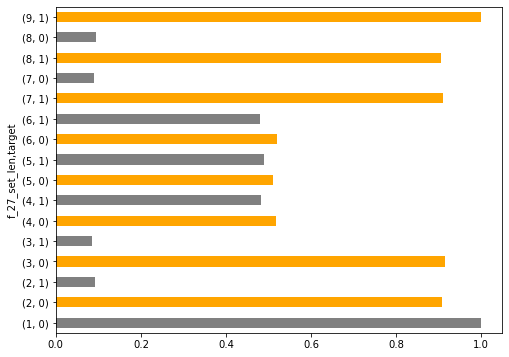

In [768]:
# Note rows that contain 1-3, 7-9 unique letters appear to be quite predictive
df.groupby('f_27_set_len').target.value_counts(normalize=True).plot.barh(color=['gray','orange'])

#### Enumerate each letter and assign to a positional column

In [249]:
# For string value of each row, convert each letter to ordered number then populate into corresponding positional column
# (Couldn't execute this as a loop or as a function, results don't seem to pass thru)
f_27_num = [[ord(df.f_27[i][n])-ord('A') for n in range(10)] for i in range(len(df))]
df3 = pd.DataFrame(f_27_num)
df = augment(df,df3)

f_27_num = [[ord(df_test.f_27[i][n])-ord('A') for n in range(10)] for i in range(len(df_test))]
df3 = pd.DataFrame(f_27_num)
df_test = augment(df_test,df3)

### Combining float features
#### Although we had identified key features in EDA, we couldn't quite grasp how to feature engineer them till reading an inspiring writeup by top Kaggler
##### https://www.kaggle.com/code/ambrosm/tpsmay22-eda-which-makes-sense

<AxesSubplot:xlabel='f_02', ylabel='f_21'>

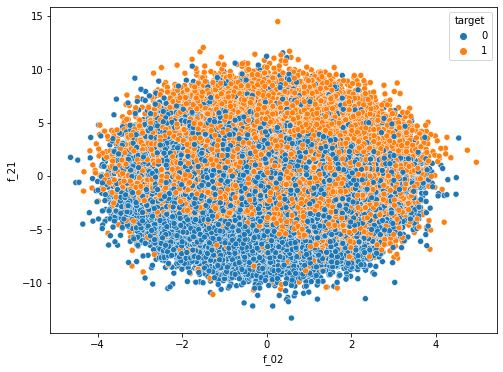

In [120]:
# The scatterplot of two features shows tendency to cluster according to target
sns.scatterplot(x='f_02', y='f_21', hue='target', data=df)

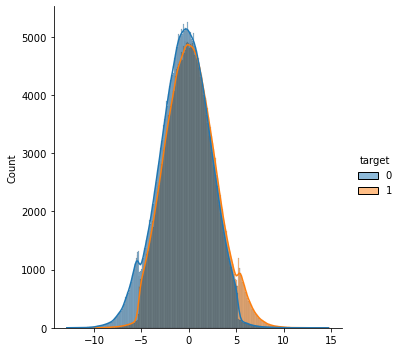

In [62]:
# This is better visualized as density plot where mixing feature f_02 to f_21 results in small spikes in the tails which 
# allows convenient binning of the data
sns.displot(df, x=df[['f_02','f_21']].sum(axis=1), hue='target', kde=True)

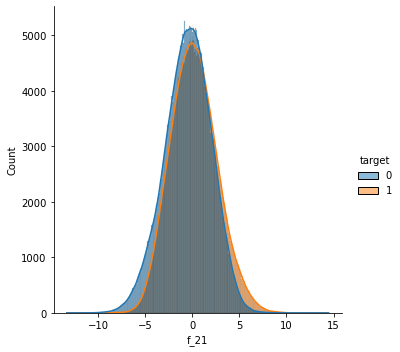

In [268]:
# Compare with plot for f_21 alone, note it is unimodal (not tri) normal curve, but the tails are useful for segmenting data
sns.displot(df, x='f_21', hue='target', kde=True)

In [250]:
# engineering features from float columns
df['sum_05_22'] = (df.f_22 + df.f_05 > 5.1).astype(int) - (df.f_22 + df.f_05 < -5.4).astype(int)
df_test['sum_05_22'] = (df_test.f_22 + df_test.f_05 > 5.1).astype(int) - (df_test.f_22 + df_test.f_05 < -5.4).astype(int)

In [251]:
df['sum_02_21'] = (df.f_21 + df.f_02 > 5.2).astype(int) - (df.f_21 + df.f_02 < -5.3).astype(int)
df_test['sum_02_21'] = (df_test.f_21 + df_test.f_02 > 5.2).astype(int) - (df_test.f_21 + df_test.f_02 < -5.3).astype(int)

In [252]:
df['sum_00_01_26'] = (df.f_26 + df.f_01 + df.f_00 > 5).astype(int) - (df.f_26 + df.f_01 + df.f_00 < -5).astype(int)
df_test['sum_00_01_26'] = (df_test.f_26 + df_test.f_01 + df_test.f_00 > 5).astype(int) - (df_test.f_26 + df_test.f_01 + df_test.f_00 < -5).astype(int)

In [267]:
# We attempted many more combinations of float features but did not identify other useful features

### Export modified DataFrames to csv 

In [259]:
# Final checks on df before exporting
print(f'df: {df.shape},  df_test: {df_test.shape}\n\n{df.columns}')

df: (900000, 47),  df_test: (700000, 46)

Index([          'id',         'f_00',         'f_01',         'f_02',
               'f_03',         'f_04',         'f_05',         'f_06',
               'f_07',         'f_08',         'f_09',         'f_10',
               'f_11',         'f_12',         'f_13',         'f_14',
               'f_15',         'f_16',         'f_17',         'f_18',
               'f_19',         'f_20',         'f_21',         'f_22',
               'f_23',         'f_24',         'f_25',         'f_26',
               'f_27',         'f_28',         'f_29',         'f_30',
             'target', 'f_27_set_len',              0,              1,
                    2,              3,              4,              5,
                    6,              7,              8,              9,
          'sum_05_22',    'sum_02_21', 'sum_00_01_26'],
      dtype='object')


In [260]:
# Exporting modified DataFrames to csv for ML analysis
df.to_csv('df_train.csv'), df_test.to_csv('df_test.csv')

(None, None)

### Discarded Feature Engineering: Clustered the data hoping to improve predictability but was minimal impact

In [169]:
#Using Elbow method
from sklearn.cluster import KMeans

#kmeans= KMeans(n_clusters = 5, max_iter = 300, random_state = 0, init = 'k-means++', n_init = 10)
kmeans= KMeans(n_clusters = 5, random_state = 28, init = 'k-means++')
y_kmeans = kmeans.fit_predict(X)


([<matplotlib.patches.Wedge at 0x2a09f5c74c0>,
 [Text(0.6425780040026388, 0.8928009345716351, ''),
  Text(-0.6640891303700369, 0.8769182555542838, ''),
  Text(-1.0600909373530014, 0.29361063424548367, ''),
  Text(-0.7410035589304403, -0.81296600522557, ''),
  Text(0.7914445316952857, -0.7639473497889956, '')])

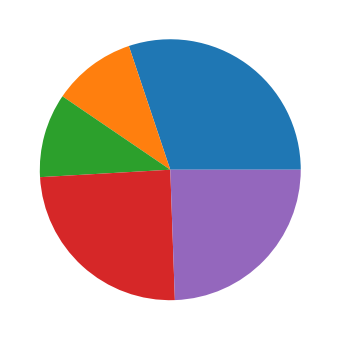

In [170]:
plt.pie(np.unique(y_kmeans, return_counts=True)[1])

In [173]:
df['category'] = pd.Series(y_kmeans)

In [174]:
df.head()

,id,f_00,f_01,f_02,f_03,f_04,f_05,f_06,f_07,f_08,...,f_23,f_24,f_25,f_26,f_27,f_28,f_29,f_30,target,category
0,0,-1.373246,0.238887,-0.243376,0.567405,-0.647715,0.839326,0.113133,1,5,...,0.766952,-2.730628,-0.208177,1.363402,ABABDADBAB,67.609153,0,0,0,0
1,1,1.697021,-1.710322,-2.230332,-0.545661,1.113173,-1.552175,0.447825,1,3,...,-0.633658,-1.217077,-3.782194,-0.058316,ACACCADCEB,377.096415,0,0,1,1
2,2,1.681726,0.616746,-1.027689,0.810492,-0.609086,0.113965,-0.708660,1,0,...,-0.520558,-0.009121,2.788536,-3.703488,AAAEABCKAD,-195.599702,0,2,1,3
3,3,-0.118172,-0.587835,-0.804638,2.086822,0.371005,-0.128831,-0.282575,3,2,...,-1.653213,1.686035,-2.533098,-0.608601,BDBBAACBCB,210.826205,0,0,1,4
4,4,1.148481,-0.176567,-0.664871,-1.101343,0.467875,0.500117,0.407515,3,3,...,-1.430366,2.127649,-3.306784,4.371371,BDBCBBCHFE,-217.211798,0,1,1,3
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
899995,899995,1.380145,-0.038884,0.597111,0.854560,0.684301,-1.058618,1.310699,2,1,...,0.522019,0.833047,2.714125,1.290094,BABBCBBBED,455.033851,0,2,1,1
899996,899996,-1.369789,0.044841,0.015458,0.376565,-0.380529,-0.830815,-1.798458,4,1,...,-0.674942,-0.412111,-0.030436,-3.144047,BBBGBBDQBE,134.703577,0,1,0,4
899997,899997,1.386201,-0.961150,0.725994,-0.132844,0.873911,-0.245339,-1.045786,0,0,...,-4.560773,-1.249154,1.793535,2.253696,AEBEDBBHBA,-99.536313,0,1,0,3
899998,899998,-1.590572,-0.509938,-1.715397,-0.249988,1.359933,1.650808,-0.058592,0,2,...,2.110008,0.561271,-2.149610,1.019982,ADBAAADDAE,47.823039,1,2,0,0


In [185]:
df[(df.category==0)].drop(['id','f_27'],axis=1)

,f_00,f_01,f_02,f_03,f_04,f_05,f_06,f_07,f_08,f_09,...,f_22,f_23,f_24,f_25,f_26,f_28,f_29,f_30,target,category
0,-1.373246,0.238887,-0.243376,0.567405,-0.647715,0.839326,0.113133,1,5,1,...,-2.540739,0.766952,-2.730628,-0.208177,1.363402,67.609153,0,0,0,0
5,1.349785,1.100418,0.562612,-0.607076,1.264728,0.283515,-1.131953,6,2,4,...,-2.259781,-1.308329,-2.216110,1.016892,0.273792,45.890998,0,1,0,0
8,0.866221,0.842351,-1.367634,1.237506,0.682962,0.845666,0.173852,3,2,1,...,-1.241121,-1.245038,1.696402,0.354545,-0.541267,-52.223857,0,0,0,0
9,0.829142,-0.082872,-0.206667,-0.032502,0.366289,0.277981,-1.113467,2,0,2,...,-3.117106,-3.609328,2.677487,-1.772600,-3.053609,-42.976312,0,0,1,0
13,0.594253,1.705987,-0.803039,0.707572,-1.144791,0.706629,-0.685819,3,3,4,...,0.347511,-0.808147,-3.170256,2.013181,1.755256,4.132834,1,1,1,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
899986,1.042892,0.913584,-0.269256,-0.193585,0.484486,0.345583,-0.260390,2,3,3,...,-2.694837,-0.293359,-1.963943,-0.881362,1.021313,-6.856800,0,1,0,0
899989,1.181490,-0.710265,2.162140,-1.804360,-0.332605,-0.216733,1.017276,4,5,1,...,5.575380,1.029736,-2.966471,-1.197924,7.035493,-52.832994,0,2,1,0
899992,1.057359,0.120543,-0.399940,0.765184,0.338755,0.177941,-0.476372,5,3,2,...,3.692304,-1.612136,0.520150,-1.870815,0.592276,85.877601,0,0,1,0
899998,-1.590572,-0.509938,-1.715397,-0.249988,1.359933,1.650808,-0.058592,0,2,2,...,2.423670,2.110008,0.561271,-2.149610,1.019982,47.823039,1,2,0,0


In [189]:
# make Category 0 training data
X_train = df[(df.category==0)].drop(['id','f_27','target','category'],axis=1)
y_train = df[(df.category==0)].target

In [194]:
# make Category 1 testing data
X_test = df[(df.category==2)].drop(['id','f_27','target','category'],axis=1)
y_test = df[(df.category==2)].target

In [200]:
#Call the DT Classifier
from sklearn.tree import DecisionTreeClassifier
#Initiating the classifier
model_dt = DecisionTreeClassifier(criterion='entropy')
#Passing the data to the classifier
model_dt.fit(X_train, y_train)

DecisionTreeClassifier(criterion='entropy')

In [201]:
y_pred_dt = model_dt.predict(X_test)

In [202]:
#Classification Metrics - To check the final results
from sklearn.metrics import confusion_matrix, classification_report, accuracy_score

result1 = accuracy_score(y_test, y_pred_dt)
print('Accuracy is: ', result1*100)

Accuracy is:  67.30176669403247
